# Linear Regression


## Project Objective

In this project, we will build a Linear Regression model to predict house prices using the Ames Housing dataset. We will:

- Use the final, feature-engineered version of the dataset.
- Prepare the data for modeling (including scaling and splitting).
- Perform a grid search to select the optimal model parameters.
- Train the model on the training data.
- Evaluate model performance on the test set using standard regression metrics.
- Visualize and interpret the results.

---

##  Setup and Imports

We begin by importing the core libraries needed for data manipulation, visualization, and modeling.

---

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.linear_model import ElasticNet
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.preprocessing import StandardScaler

import matplotlib_inline
matplotlib_inline.backend_inline.set_matplotlib_formats('svg')

import warnings
from sklearn.exceptions import ConvergenceWarning

warnings.filterwarnings("ignore", category=ConvergenceWarning)


### Data

We will load the final, feature-engineered Ames Housing dataset, which will be used throughout the modeling process.

---

In [2]:
df = pd.read_csv("DATA/AMES.csv")

### Exploratory Data Analysis (EDA)

Let's explore the Ames Housing dataset to understand its structure, check for missing values, and visualize key features. This will help guide our preprocessing and modeling decisions.

---

In [3]:
df.head()

,Lot Frontage,Lot Area,Overall Qual,Overall Cond,Year Built,Year Remod/Add,Mas Vnr Area,BsmtFin SF 1,BsmtFin SF 2,Bsmt Unf SF,...,Sale Type_ConLw,Sale Type_New,Sale Type_Oth,Sale Type_VWD,Sale Type_WD,Sale Condition_AdjLand,Sale Condition_Alloca,Sale Condition_Family,Sale Condition_Normal,Sale Condition_Partial
0,141.0,31770,6,5,1960,1960,112.0,639.0,0.0,441.0,...,0,0,0,0,1,0,0,0,1,0
1,80.0,11622,5,6,1961,1961,0.0,468.0,144.0,270.0,...,0,0,0,0,1,0,0,0,1,0
2,81.0,14267,6,6,1958,1958,108.0,923.0,0.0,406.0,...,0,0,0,0,1,0,0,0,1,0
3,93.0,11160,7,5,1968,1968,0.0,1065.0,0.0,1045.0,...,0,0,0,0,1,0,0,0,1,0
4,74.0,13830,5,5,1997,1998,0.0,791.0,0.0,137.0,...,0,0,0,0,1,0,0,0,1,0


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2925 entries, 0 to 2924
Columns: 274 entries, Lot Frontage to Sale Condition_Partial
dtypes: float64(11), int64(263)
memory usage: 6.1 MB


In [5]:
print("Shape:", df.shape)

Shape: (2925, 274)


### Visualize target distribution

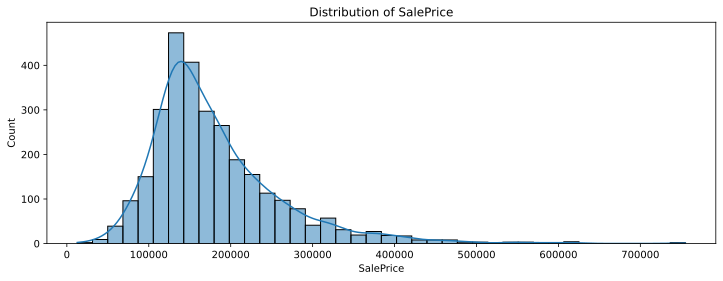

In [6]:
plt.figure(figsize=(12,4))
sns.histplot(df['SalePrice'], kde=True, bins=40)
plt.title('Distribution of SalePrice')
plt.xlabel('SalePrice')
plt.savefig('visualisations/SalePrice_Distribution.svg')

### Year Built vs. SalePrice

This scatter plot visualizes the relationship between the year a house was built and its sale price. Newer houses generally tend to have higher sale prices, but there may be notable exceptions and trends worth exploring.

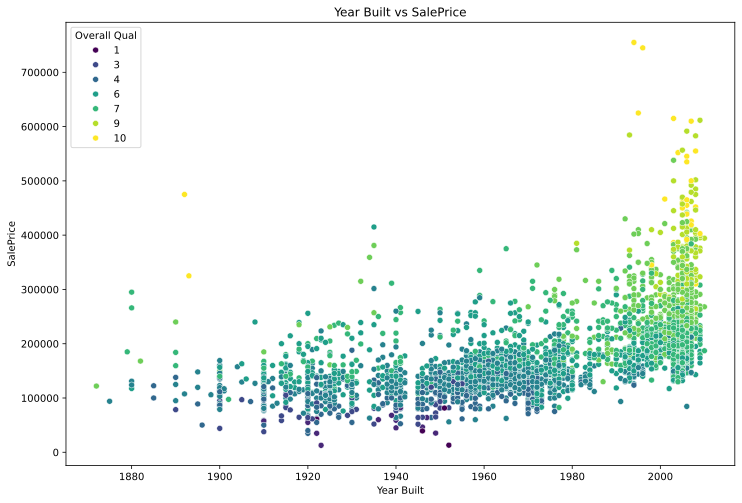

In [7]:
plt.figure(figsize=(12,8))
sns.scatterplot(data=df, x='Year Built', y='SalePrice',hue='Overall Qual', palette='viridis')
plt.title('Year Built vs SalePrice')
plt.xlabel('Year Built')
plt.ylabel('SalePrice')
plt.savefig('visualisations/Year_Built_vs_SalePrice.svg')


### Correlation Analysis

This scatter plot visualizes the relationship between overall house quality and its sale price. Higher quality houses generally tend to have higher sale prices, but there may be notable exceptions and trends worth exploring.

---

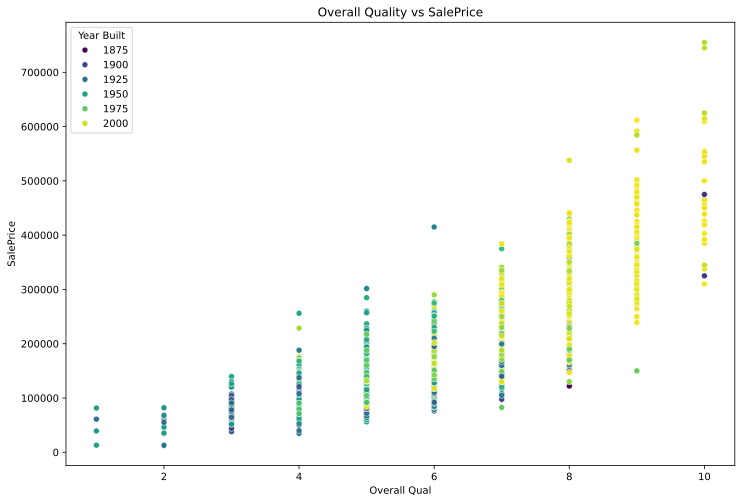

In [8]:
plt.figure(figsize=(12,8))
sns.scatterplot(data=df, x='Overall Qual', y='SalePrice',hue='Year Built', palette='viridis')
plt.title('Overall Quality vs SalePrice')
plt.savefig('visualisations/Overall_Quality_vs_SalePrice.svg')


### Lot Area vs. SalePrice (Colored by SalePrice)

This scatter plot visualizes the relationship between lot area and sale price, with color intensity representing the sale price itself. This helps highlight the distribution of high- and low-priced properties across different lot sizes.

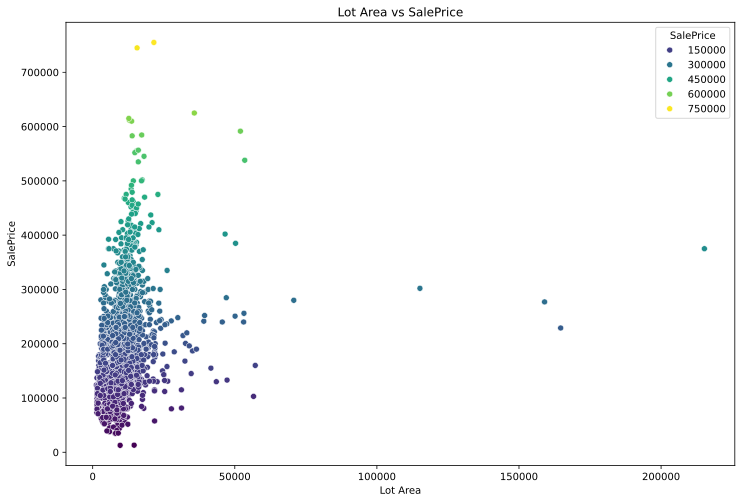

In [9]:

plt.figure(figsize=(12,8))
sns.scatterplot(data=df, x='Lot Area', y='SalePrice',hue='SalePrice', palette='viridis')
plt.title('Lot Area vs SalePrice')
plt.savefig('visualisations/Lot_Area_vs_SalePrice.svg')

### Correlation heatmap (top features)

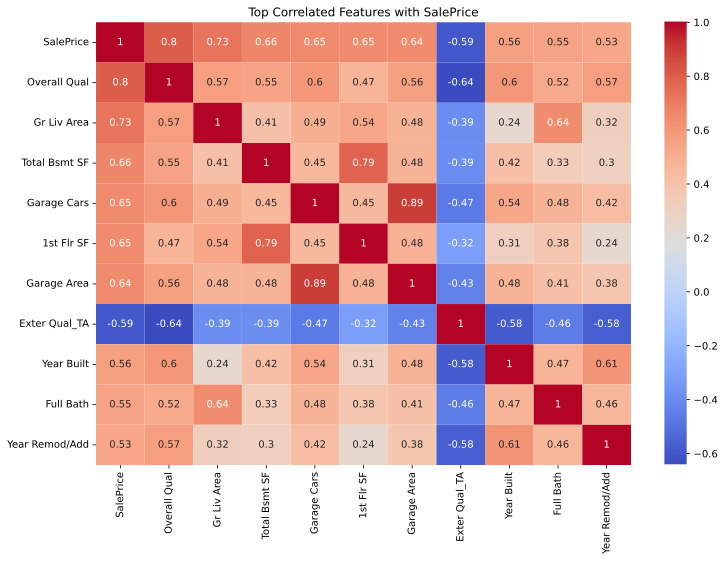

In [10]:
plt.figure(figsize=(12,8))
corr = df.corr()
top_corr = corr['SalePrice'].abs().sort_values(ascending=False).head(11).index
sns.heatmap(df[top_corr].corr(), annot=True, cmap='coolwarm')
plt.title('Top Correlated Features with SalePrice')
plt.savefig('visualisations/Correlation_Heatmap.svg')

### Pairplot of Top Correlated Features

This pairplot visualizes the relationships between the features most strongly correlated with SalePrice. It helps reveal linear trends, clusters, and potential outliers among the most influential variables in the dataset.

In [11]:
corr = df.corr()
top_corr = corr['SalePrice'].abs().sort_values(ascending=False).head(5).index
sns.pairplot(df[top_corr],hue='SalePrice',height=4,aspect=0.7)
plt.savefig('visualisations/pairplot.svg')

### Model Training

We will train a linear regression model using the prepared training data. This includes fitting the model and preparing it for evaluation on the test set.

### Feature and Label Separation

We will now separate the dataset into features (`X`) and the target label (`y`). The target variable for prediction is the `SalePrice` column.


In [12]:
X = df.drop('SalePrice',axis=1)
y = df['SalePrice']

### Train-Test Split

We will split the data into training and test sets using scikit-learn. The test set will be 10% of the data, with `random_state=42` for reproducibility.

In [13]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.10, random_state=42)

### Feature Scaling

To ensure optimal regression performance, we will scale the feature matrix `X` so that all features have comparable ranges and units.

In [14]:
scaler = StandardScaler()
scaled_X_train = scaler.fit_transform(X_train)
scaled_X_test = scaler.transform(X_test)

### Model Selection: Elastic Net

We will use an Elastic Net regression model, which combines both L1 and L2 regularization. Let's create an instance of the default ElasticNet model from scikit-learn.

In [15]:
base_elastic_model = ElasticNet(max_iter=1000)

### Hyperparameter Grid

The Elastic Net model has two main hyperparameters: `alpha` (regularization strength) and `l1_ratio` (balance between L1 and L2 penalties). We will define a parameter grid to use for hyperparameter tuning.
- `alpha`: Controls the overall strength of regularization. Higher values of `alpha` increase the amount of regularization, which can help prevent overfitting but may also reduce model flexibility.
- `l1_ratio`: Sets the balance between L1 (Lasso) and L2 (Ridge) penalties. An `l1_ratio` of 1 is equivalent to Lasso, while 0 is equivalent to Ridge.


In [16]:
param_grid = {'alpha':[0.1,1,5,10,50,100],
              'l1_ratio':[.1, .5, .7, .9, 1]}

### Hyperparameter Tuning with Grid Search

We will use scikit-learn's `GridSearchCV` to search for the best combination of `alpha` and `l1_ratio` for our Elastic Net model, using the scaled training data. This approach helps us select the optimal regularization settings for improved model performance.

In [17]:

grid_model = GridSearchCV(estimator=base_elastic_model,
                          param_grid=param_grid,
                          scoring='neg_mean_squared_error',
                          cv=5,
                          verbose=1)

In [18]:
grid_model.fit(scaled_X_train,y_train)

Fitting 5 folds for each of 30 candidates, totalling 150 fits


GridSearchCV(cv=5, estimator=ElasticNet(),
             param_grid={'alpha': [0.1, 1, 5, 10, 50, 100],
                         'l1_ratio': [0.1, 0.5, 0.7, 0.9, 1]},
             scoring='neg_mean_squared_error', verbose=1)

### Best Model Parameters

After running grid search, we can display the best combination of `alpha` and `l1_ratio` found for the Elastic Net model.

In [19]:
best_model = grid_model.best_estimator_
grid_model.best_params_

{'alpha': 100, 'l1_ratio': 1}

### Model Evaluation

Now we will evaluate the performance of our model on the unseen (10%) scaled test set.

In [20]:

y_pred = grid_model.predict(scaled_X_test)

### Test Set Metrics

The following metrics summarize the model's performance on the test set:

- **Mean Absolute Error (MAE):** Measures the average absolute difference between predicted and actual sale prices.
- **Root Mean Squared Error (RMSE):** Penalizes larger errors more heavily and is in the same units as the target variable.

Lower values indicate better model performance.

In [21]:
MAE = mean_absolute_error(y_test,y_pred)
RMSE = np.sqrt(mean_squared_error(y_test,y_pred))

print(f"MAE: ${MAE:.2f}")
print(f"RMSE: ${RMSE:.2f}")

MAE: $13696.99
RMSE: $21651.72


In [22]:
mean_house_price_in_df = np.mean(df['SalePrice'])

print(f"Mean Sale Price: ${mean_house_price_in_df:.2f}")


Mean Sale Price: $180815.54


## Model Persistence

To reuse the trained model in the future without retraining, we will save it to disk. This allows for easy deployment or further analysis at a later time.

In [23]:
import joblib

### Final Model Training on Complete Data

Now that we have selected the best model and hyperparameters, we retrain the model using the entire dataset. This ensures the model benefits from all available data before being saved for future use.

In [26]:
scaled_X = scaler.fit_transform(X)
best_model = best_model.fit(scaled_X,y)

In [28]:
joblib.dump(best_model, 'models/best_model.joblib')
joblib.dump(scaler, 'models/scaler.joblib')

['models/scaler.joblib']

### Conclusion

In this project, we developed a linear regression model to predict house prices using the Ames Housing dataset. Through careful data exploration, preprocessing, and hyperparameter tuning, we achieved strong predictive performance on unseen data. The final model was trained on the complete dataset and saved for future use.

This workflow demonstrates the importance of robust EDA, feature scaling, and model selection in building effective regression models for real-world data.